## Imports

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
import numpy as np
import pandas as pd
import pickle as pkl
from datetime import datetime
from dateutil import parser
from datetime import datetime
from sys import getsizeof
import re

import operator
from scipy import stats

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline
plt.rcParams['figure.figsize'] = (12.0, 8.0)
plt.rcParams['axes.axisbelow'] = True

from plotly.offline import init_notebook_mode, plot, iplot
import plotly.graph_objs as go
import plotly.io as pio
from plotly.subplots import make_subplots
init_notebook_mode(True)

from hallprobecalib import hpc_ext_path
from hallprobecalib.hpcplots import scatter2d,scatter3d,histo

In [4]:
plotdir = hpc_ext_path+'plots/hall_probe_stability/2019-08-13/'

In [5]:
pkl_dir = hpc_ext_path+"datafiles/hall_probe_stability/"
pkl_file_slow = "hall_stability.run02.raw.slow.pkl"
pkl_file_fast = "hall_stability.run02.raw.fast.pkl"
pkl_file_fast_sparse = "hall_stability.run02.sparse.fast.pkl"

In [61]:
df_slow = pd.read_pickle(pkl_dir+pkl_file_slow)

In [62]:
df_fast = pd.read_pickle(pkl_dir+pkl_file_fast)
#df_fast = pd.read_pickle(pkl_dir+pkl_file_fast_sparse)

In [63]:
df_fast.tail(1)

,Cal_1,Cal_1_Bx,Cal_1_By,Cal_1_Bz,Cal_1_T,Cal_2,Cal_2_Bx,Cal_2_By,Cal_2_Bz,Cal_2_T,...,Raw_4_Bx,Raw_4_By,Raw_4_Bz,Raw_4_T,Raw_5,Raw_5_Bx,Raw_5_By,Raw_5_Bz,Raw_5_T,NMR
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-08-14 06:23:24.751,1,-0.384785,-1.082799,-0.49073,21.59,2,0.001323,-0.000556,-0.000511,20.49,...,-71830.0,-11008.0,-19865.0,17829.0,5,63993.0,44638.0,45083.0,19077.0,1.249293


In [6]:
#len(df_fast)

In [7]:
#df_fast = df_fast.loc[:df_slow.index[-1]]

In [8]:
#df_fast.tail(1)

In [64]:
df_slow.tail(1)

,Time,Magnet Current [A],Magnet Voltage [V],Coil 1 (new),Coil 2 (old),LCW in Coil1,LCW out Coil 1,LCW in Coil 2,LCW out Coil 2,Yoke,...,LCW to magnet,NMR [T],NMR [FFT],Zaber_Meas_MicroStep_X,Zaber_Meas_Encoder_X,Zaber_Meas_MicroStep_Y,Zaber_Meas_Encoder_Y,Zaber_Meas_MicroStep_Z,Zaber_Meas_Encoder_Z,
Datetime,,,,,,,,,,,,,,,,,,,,,
2019-08-14 06:23:25,8/14/2019 6:23:25 AM,256.069138,33.722767,53.888416,51.450954,29.796928,32.984409,31.261843,36.84951,27.741047,...,30.43631,1.249293,0.0,249952.34375,639878.0,750000.0,1920000.0,750000.0,1920000.0,NaN


## Cleaning

In [9]:
directory = "/home/ckampa/Dropbox/LogFiles/"#hpc_ext_path+'datafiles/magnet_stability/nmr/'
filename_slow = '2019-08-13 115728slow.txt'
filename_fast = '2019-08-13 1155830 hallonly.txt'

In [10]:
fast_cols_init = ["Date", "Time", 
                  "1", "1_Bx", "1_By", "1_Bz", "1_T",
                  "2", "2_Bx", "2_By", "2_Bz", "2_T",
                  "3", "3_Bx", "3_By", "3_Bz", "3_T",
                  "4", "4_Bx", "4_By", "4_Bz", "4_T",
                  "5", "5_Bx", "5_By", "5_Bz", "5_T",]

In [11]:
df_slow = pd.read_csv(directory+filename_slow)

In [12]:
df_fast = pd.read_csv(directory+filename_fast, skiprows=7, delim_whitespace=True, names=fast_cols_init)

### Cleaning Fast Data Set

In [13]:
#df_fast

In [14]:
'''fast_cols_init = ["Date", "Time", 
                  "1", "1_Bx", "1_By", "1_Bz", "1_T",
                  "2", "2_Bx", "2_By", "2_Bz", "2_T",
                  "3", "3_Bx", "3_By", "3_Bz", "3_T",
                  "4", "4_Bx", "4_By", "4_Bz", "4_T",
                  "5", "5_Bx", "5_By", "5_Bz", "5_T",]''';

In [15]:
#len(fast_cols_init)

In [16]:
#len(df_fast.columns)

In [17]:
# raw values on every other line....
df_fast_cal = df_fast[::2]
df_fast_raw = df_fast[1::2]

In [18]:
df_fast_cal.reset_index(drop=True, inplace=True)
df_fast_raw.reset_index(drop=True, inplace=True)

In [19]:
#df_fast_cal

In [20]:
#df_fast_raw

In [21]:
#dates = [parser.parse(row.Date+" "+row.Time[:-4]) for row in df_fast_cal.itertuples()]
dates = [datetime.strptime(row.Date+" "+row.Time, "%Y-%m-%d %H:%M:%S:%f") for row in df_fast_cal.itertuples()]

In [22]:
df_fast_cal["Datetime"] = pd.to_datetime(dates)
df_fast_cal = df_fast_cal.set_index("Datetime")

In [23]:
#df_fast_cal

In [24]:
#dates = [parser.parse(row.Date+" "+row.Time[:-4]) for row in df_fast_cal.itertuples()]
dates = [datetime.strptime(row.Date[1:]+" "+row.Time, "%Y-%m-%d %H:%M:%S:%f") for row in df_fast_raw.itertuples()]

In [25]:
df_fast_raw["Datetime"] = pd.to_datetime(dates)
df_fast_raw = df_fast_raw.set_index("Datetime")

In [26]:
#df_fast_raw

In [27]:
df_fast_raw.drop(columns=["Date","Time"], inplace=True)

In [28]:
df_fast_cal.drop(columns=["Date","Time"], inplace=True)

In [29]:
raw_col_dict = {i: "Raw_"+i for i in df_fast_raw.columns}
cal_col_dict = {i: "Cal_"+i for i in df_fast_cal.columns}

In [30]:
df_fast_cal.rename(columns=cal_col_dict, inplace=True)
df_fast_raw.rename(columns=raw_col_dict, inplace=True)

In [31]:
#df_fast_cal

In [32]:
df_fast = pd.concat([df_fast_cal, df_fast_raw], axis=1)

In [33]:
#df_fast

In [34]:
#df_fast.iloc[0]

In [35]:
#getsizeof(df_fast) / 1000 / 1000

In [168]:
#df_fast.to_pickle(pkl_dir+pkl_file_fast)

In [36]:
#col_drop = [i for i in df_fast.columns if "1" not in i]

In [37]:
#col_drop

In [38]:
#df_fast_sparse = df_fast.drop(columns=col_drop)

In [172]:
#df_fast_sparse

In [173]:
#getsizeof(df_fast_sparse) / 1000 / 1000

In [39]:
#df_fast_sparse.to_pickle(pkl_dir+pkl_file_fast_sparse)

### Slow Control Data Cleaning

In [117]:
#df_slow

In [40]:
dates = [parser.parse(row.Time) for row in df_slow.itertuples()]# if isdatetime(row.Time.values[0])]

In [41]:
df_slow["Datetime"] = pd.to_datetime(dates)#.astype("str")
df_slow = df_slow.set_index("Datetime")

In [42]:
#df_slow

In [43]:
#df_slow.columns

There is no Hall probe data.

In [44]:
df_slow.to_pickle(pkl_dir+pkl_file_slow)

In [45]:
df_fast = df_fast.loc[:df_slow.index[-1]]

In [46]:
df_fast.loc[:,"NMR"] = [df_slow.iloc[df_slow.index.get_loc(row, method='nearest')][" NMR [T]"] for row in df_fast.index]

In [48]:
df_fast.to_pickle(pkl_dir+pkl_file_fast)

In [52]:
col_drop = [i for i in df_fast.columns if ("1" not in i) and ("NMR" not in i)]

In [55]:
#col_drop

In [56]:
df_fast_sparse = df_fast.drop(columns=col_drop)

In [57]:
df_fast_sparse.to_pickle(pkl_dir+pkl_file_fast_sparse)

In [58]:
getsizeof(df_slow) / 1000/1000, getsizeof(df_fast) / 1000/1000, getsizeof(df_fast_sparse) / 1000/1000

(0.3845, 27.555864, 6.359064)

## Plotting

In [65]:
len(df_fast)

66240

In [66]:
df_fast.columns

Index(['Cal_1', 'Cal_1_Bx', 'Cal_1_By', 'Cal_1_Bz', 'Cal_1_T', 'Cal_2',
       'Cal_2_Bx', 'Cal_2_By', 'Cal_2_Bz', 'Cal_2_T', 'Cal_3', 'Cal_3_Bx',
       'Cal_3_By', 'Cal_3_Bz', 'Cal_3_T', 'Cal_4', 'Cal_4_Bx', 'Cal_4_By',
       'Cal_4_Bz', 'Cal_4_T', 'Cal_5', 'Cal_5_Bx', 'Cal_5_By', 'Cal_5_Bz',
       'Cal_5_T', 'Raw_1', 'Raw_1_Bx', 'Raw_1_By', 'Raw_1_Bz', 'Raw_1_T',
       'Raw_2', 'Raw_2_Bx', 'Raw_2_By', 'Raw_2_Bz', 'Raw_2_T', 'Raw_3',
       'Raw_3_Bx', 'Raw_3_By', 'Raw_3_Bz', 'Raw_3_T', 'Raw_4', 'Raw_4_Bx',
       'Raw_4_By', 'Raw_4_Bz', 'Raw_4_T', 'Raw_5', 'Raw_5_Bx', 'Raw_5_By',
       'Raw_5_Bz', 'Raw_5_T', 'NMR'],
      dtype='object')

In [67]:
df_fast.eval("Cal_1_Bmag = (Cal_1_Bx**2+Cal_1_By**2+Cal_1_Bz**2)**(1/2)", inplace = True)

In [69]:
N = 10#30#60
df_fast.loc[:, "Cal_1_Bmag_Avg"] = df_fast["Cal_1_Bmag"].rolling(window = N, center=True).mean()
df_fast.loc[:, "Cal_1_Bmag_Avg_Res_Rel"] = (df_fast["NMR"] - df_fast["Cal_1_Bmag_Avg"])/df_fast["NMR"]

In [279]:
df_fast_5 = df_fast[N // 2::N]

In [ ]:
#df_fast_5.loc[:, "Cal_Mag_Avg"] = [df_fast.iloc[i- for i in range(len(df_fast_5))]

In [ ]:
### 60 second

In [266]:
fig = scatter2d([df_fast.index,df_fast.index,df_fast_5.index], [df_fast.Cal_1_Bmag,df_fast.Cal_1_Bmag_Avg,df_fast_5.Cal_1_Bmag_Avg], inline=True)

In [274]:
### 30 second

In [275]:
fig = scatter2d([df_fast.index,df_fast.index,df_fast_5.index], [df_fast.Cal_1_Bmag,df_fast.Cal_1_Bmag_Avg,df_fast_5.Cal_1_Bmag_Avg], inline=True)

In [280]:
### 10 second

fig = scatter2d([df_fast.index,df_fast.index,df_fast_5.index], [df_fast.Cal_1_Bmag,df_fast.Cal_1_Bmag_Avg,df_fast_5.Cal_1_Bmag_Avg], inline=True)

In [229]:
fig = scatter2d(df_fast.index, df_fast.Cal_1_Bmag, inline=True)

In [267]:
fig = histo(df_fast.Cal_1_Bmag, bins=25, inline=True)
fig = histo(df_fast.Cal_1_Bmag_Avg, bins=25, inline=True)
fig = histo(df_fast_5.Cal_1_Bmag_Avg, bins=25, inline=True)

In [246]:
15214/508

29.948818897637796

In [220]:
#df_fast.loc[:,"NMR"] = [df_slow.iloc[df_slow.index.get_loc(row, method='nearest')][" NMR [T]"] for row in df_fast.index]

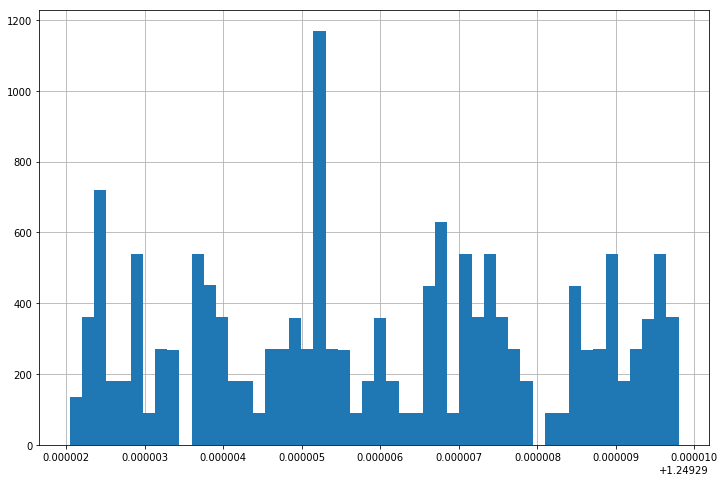

In [268]:
df_fast.NMR.hist(bins=50)

In [221]:
df_fast.NMR

Datetime
2019-08-13 11:58:53.416    1.249299
2019-08-13 11:58:54.416    1.249299
2019-08-13 11:58:55.417    1.249299
2019-08-13 11:58:56.417    1.249299
2019-08-13 11:58:57.418    1.249299
2019-08-13 11:58:58.418    1.249299
2019-08-13 11:58:59.419    1.249299
2019-08-13 11:59:00.419    1.249299
2019-08-13 11:59:01.420    1.249299
2019-08-13 11:59:02.420    1.249299
2019-08-13 11:59:03.421    1.249299
2019-08-13 11:59:04.421    1.249299
2019-08-13 11:59:05.422    1.249299
2019-08-13 11:59:06.422    1.249299
2019-08-13 11:59:07.422    1.249299
2019-08-13 11:59:08.423    1.249299
2019-08-13 11:59:09.423    1.249299
2019-08-13 11:59:10.424    1.249299
2019-08-13 11:59:11.425    1.249299
2019-08-13 11:59:12.425    1.249299
2019-08-13 11:59:13.426    1.249299
2019-08-13 11:59:14.427    1.249299
2019-08-13 11:59:15.427    1.249299
2019-08-13 11:59:16.428    1.249299
2019-08-13 11:59:17.428    1.249299
2019-08-13 11:59:18.429    1.249299
2019-08-13 11:59:19.430    1.249299
2019-08-13 11:59:20

In [222]:
df_fast.eval("Cal_Res = (NMR - Cal_1_Bmag)", inplace=True)
df_fast.eval("Cal_Res_Rel = (NMR - Cal_1_Bmag) / NMR", inplace=True)

In [253]:
fig = histo(df_fast.Cal_Res_Rel, bins=50, inline=True)
fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)
fig = histo(df_fast_5.Cal_1_Bmag_Avg_Res_Rel, bins=10, inline=True)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)

In [ ]:
### 60 second average

In [269]:
fig = histo([df_fast.Cal_1_Bmag,df_fast.Cal_1_Bmag_Avg], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
#fig = histo([df_fast.Cal_Res_Rel,df_fast_5.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
#fig.update_traces(histnorm='probability density')
#iplot(fig)

In [270]:
fig = histo([df_fast.Cal_Res_Rel,df_fast.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
fig = histo([df_fast.Cal_Res_Rel,df_fast_5.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)
#fig = histo(df_fast_5.Cal_1_Bmag_Avg_Res_Rel, bins=10, inline=True)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)

In [271]:
### 30 Second Average

In [276]:
fig = histo([df_fast.Cal_1_Bmag,df_fast.Cal_1_Bmag_Avg], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
#fig = histo([df_fast.Cal_Res_Rel,df_fast_5.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
#fig.update_traces(histnorm='probability density')
#iplot(fig)
fig = histo([df_fast.Cal_Res_Rel,df_fast.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
fig = histo([df_fast.Cal_Res_Rel,df_fast_5.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)
#fig = histo(df_fast_5.Cal_1_Bmag_Avg_Res_Rel, bins=10, inline=True)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)

In [277]:
## 10 second

In [281]:
fig = histo([df_fast.Cal_1_Bmag,df_fast.Cal_1_Bmag_Avg], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
#fig = histo([df_fast.Cal_Res_Rel,df_fast_5.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
#fig.update_traces(histnorm='probability density')
#iplot(fig)
fig = histo([df_fast.Cal_Res_Rel,df_fast.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
fig = histo([df_fast.Cal_Res_Rel,df_fast_5.Cal_1_Bmag_Avg_Res_Rel], bins=50,same_bins=True, show_plot=False, inline=True)
fig.update_traces(histnorm='probability density')
iplot(fig)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)
#fig = histo(df_fast_5.Cal_1_Bmag_Avg_Res_Rel, bins=10, inline=True)
#fig = histo(df_fast.Cal_1_Bmag_Avg_Res_Rel, bins=50, inline=True)

In [285]:
N2 = 5
df_fast["NMR_noise"] = df_fast.NMR - df_fast.NMR.rolling(window=N2, center=True).mean()

In [288]:
fig = histo([df_fast.Cal_Res_Rel,df_fast_5.Cal_1_Bmag_Avg_Res_Rel, df_fast[::100].NMR_noise], bins=50,same_bins=False, show_plot=False, inline=True)
#fig.update_traces(histnorm='probability density')
iplot(fig)

In [292]:
fig = histo(df_slow[" NMR [T]"], bins=10, inline=True)

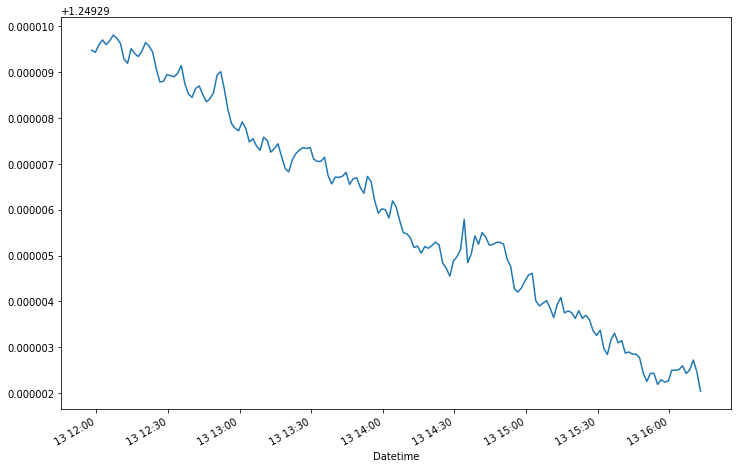

In [293]:
df_slow[" NMR [T]"].plot()